# The Movie Dataset
**Exploratory Data Analysis**  
Ben Felder  
*August 30, 2021*


## Introduction

**What is Exploratory Data Analysis ?**

Exploratory Data Analysis or (EDA) is understanding the data sets by summarizing their main characteristics often plotting them visually. This step is very important especially when we arrive at modeling the data in order to apply Machine learning. Plotting in EDA consists of Histograms, Box plot, Scatter plot and many more. It often takes much time to explore the data. Through the process of EDA, we can ask to define the problem statement or definition on our data set which is very important.

**How to perform Exploratory Data Analysis**

There are some common methods and plots that would be used in the EDA process.  

1.   Data Exploration
2.   Data Cleaning
3.   Model Building
4.   Presenting Results


**What data is being explored ?**

Dataset Name: The Movies Dataset  

Dataset Description: *These files contain metadata for all 45,000 movies listed in the Full MovieLens Dataset. The dataset consists of movies released on or before July 2017. Data points include cast, crew, plot keywords, budget, revenue, posters, release dates, languages, production companies, countries, TMDB vote counts and vote averages.*
*This dataset also has files containing 26 million ratings from 270,000 users for all 45,000 movies. Ratings are on a scale of 1-5 and have been obtained from the official GroupLens website.*  

Dataset Source: Kaggle  

Dataset Link: https://www.kaggle.com/rounakbanik/the-movies-dataset

***Acknowledgements***  
*This dataset is an ensemble of data collected from TMDB and GroupLens.
The Movie Details, Credits and Keywords have been collected from the TMDB Open API. This product uses the TMDb API but is not endorsed or certified by TMDb. Their API also provides access to data on many additional movies, actors and actresses, crew members, and TV shows. You can try it for yourself here.*
*The Movie Links and Ratings have been obtained from the Official GroupLens website. The files are a part of the dataset available here*



## Dataset ROCCC Assessment
1.  Reliable - MED - Dataset obtained via MovieLens/TMDB, extenral data source, accuracy unknown, bias unknown, leading unknown.
2.  Original - MED - Dataset original source not internal data source.
3.  Comprehensive - HIGH - Dataset shows over 45,000 movie entries, 
4.  Current - MED - Dataset is current as of 2017.  Dataset is relevant to EDA.
5.  Cited - MED - Source has been cited, but unvetted.


**What data questions are hoping to be answered after analysis?**



1.   What are the highest grossing movies?  Highest budget movies?
2.   What movies receive higher votes or ratings?
3.   What metrics make a successful movie?
4.   What studios/company has highest grossing movies?  Highest budget movies





---



## 1. Importing libraries

Below are the libraries that are used in order to perform EDA (Exploratory Data Analysis).



*Pathlib* - Object-oriented filesystem paths  
*Sys* - System-specific parameters and functions  
*OS* - Operating system dependent functionality  
*Pandas* - Data analysis and manipulation tool  
*Numpy* - Multi-dimensional arrays and matrices, and high-level mathematical functions  
*Seaborn* - Statistical data visualizations  
*Matplotlib* - Plotting visualizations

In [2]:
# Infrastructure
from pathlib import Path
import sys
import os

# Science and Data
import pandas as pd  
import numpy as np

# Plotting Tools
import seaborn as sns
import matplotlib.pyplot as plt

print('Import Libraries Complete')

Import Libraries Complete


Pandas and Plotting Setup Options

In [3]:
# Pandas
pd.set_option('display.max_rows', 100)
pd.options.display.float_format = "{:,.2f}".format

# Matplotlib
%matplotlib inline
plt.rcParams['figure.figsize'] = (20, 10)
plt.rcParams['axes.spines.left'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.bottom'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['xtick.labelbottom'] = True
plt.rcParams['ytick.labelleft'] = True
plt.rcParams.update({'font.size': 18})


print('Library Setup Options Complete')

Library Setup Options Complete


Path Setup Options

In [4]:
'''
PROJECT_ROOT = !git rev-parse --show-toplevel
PROJECT_ROOT = Path(PROJECT_ROOT[0])

print('Path Setup Complete)
''' 

"\nPROJECT_ROOT = !git rev-parse --show-toplevel\nPROJECT_ROOT = Path(PROJECT_ROOT[0])\n\nprint('Path Setup Complete)\n"

Machine Learning using Scikit-Learn

Python Data Science Handbook  
Introducing SciKit-Learn for Google Colab  
[Link](
https://colab.research.google.com/github/jakevdp/PythonDataScienceHandbook/blob/master/notebooks/05.02-Introducing-Scikit-Learn.ipynb#scrollTo=cXpxypZgp8xH)

In [5]:
'''
import sklearn as sk

print('Machine Learning Library Complete')
'''

"\nimport sklearn as sk\n\nprint('Machine Learning Library Complete')\n"



---



## 2. Downloading files

Loading the data into the pandas data frame is certainly one of the most important steps in EDA, as we can see that the value from the data set is comma-separated. So all we have to do is to just read the CSV into a data frame and pandas data frame does the job for us.

External Data Sources   
Local files: [Link](https://colab.research.google.com/notebooks/io.ipynb)  
Google Drive: [Link](https://colab.research.google.com/notebooks/io.ipynb#scrollTo=c2W5A2px3doP)  
Kaggle: [Link](https://colab.research.google.com/github/corrieann/kaggle/blob/master/kaggle_api_in_colab.ipynb#scrollTo=DsyV01gDaxls)  
Github: [Link](https://colab.research.google.com/github/googlecolab/colabtools/blob/master/notebooks/colab-github-demo.ipynb)  
  *Github requires use or raw.githubusercontent.com url*


### 2.1. Local files

In [6]:
'''
df = pd.read_csv(' ')
print('Import Data Complete')
'''

"\ndf = pd.read_csv(' ')\nprint('Import Data Complete')\n"

### 2.2. URL files

In [7]:
'''
url = (' ')
df = pd.read_csv(url)
print('Import Data Complete')
'''

"\nurl = (' ')\ndf = pd.read_csv(url)\nprint('Import Data Complete')\n"

### 2.3. Kaggle files

#### 2.3.1. Installing Kaggle API in Colab

In [8]:
'''
!pip install kaggle
'''

'\n!pip install kaggle\n'

#### 2.3.2. Authenticating with Kaggle using kaggle.json

In [9]:
'''
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))
  
# Then move kaggle.json into the folder where the API expects to find it.
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json
'''

'\nfrom google.colab import files\n\nuploaded = files.upload()\n\nfor fn in uploaded.keys():\n  print(\'User uploaded file "{name}" with length {length} bytes\'.format(\n      name=fn, length=len(uploaded[fn])))\n  \n# Then move kaggle.json into the folder where the API expects to find it.\n!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json\n'

#### 2.3.3. Listing competitions

In [10]:
'''
!kaggle competitions list
'''

'\n!kaggle competitions list\n'

#### 2.3.4. Downloading a dataset

In [11]:
'''
!kaggle datasets download "center-for-policing-equity/data-science-for-good"
'''

'\n!kaggle datasets download "center-for-policing-equity/data-science-for-good"\n'

In [12]:
'''
!unzip data-science-for-good.zip
'''

'\n!unzip data-science-for-good.zip\n'

In [13]:
'''
basepath = "Dept_23-00089/23-00089_ACS_data/23-00089_ACS_race-sex-age/"
df = pd.read_csv(basepath + "ACS_15_5YR_DP05_with_ann.csv")
print('Import Data Complete')
'''

'\nbasepath = "Dept_23-00089/23-00089_ACS_data/23-00089_ACS_race-sex-age/"\ndf = pd.read_csv(basepath + "ACS_15_5YR_DP05_with_ann.csv")\nprint(\'Import Data Complete\')\n'

### 2.4. Github files

In [14]:

url = ('https://raw.githubusercontent.com/bentegviz/data_analyst_portfolio_project/main/data/interim/movies_dataset.csv')
df = pd.read_csv(url)

print('Import Data Complete')


Import Data Complete


## 3. Data Exploration

### 3.1. Exploring the data frame first and last 5 samples

In [15]:
# To display the top 5 rows 
df.head(5)               

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.40,"927,000.00",Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,"19,000,000.00","46,998,772.00",Warner Bros.,146.00
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.80,"65,000.00",Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,"4,500,000.00","58,853,106.00",Columbia Pictures,104.00
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.70,"1,200,000.00",Irvin Kershner,Leigh Brackett,Mark Hamill,United States,"18,000,000.00","538,375,067.00",Lucasfilm,124.00
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.70,"221,000.00",Jim Abrahams,Jim Abrahams,Robert Hays,United States,"3,500,000.00","83,453,539.00",Paramount Pictures,88.00
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.30,"108,000.00",Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,"6,000,000.00","39,846,344.00",Orion Pictures,98.00


In [16]:
# To display the botton 5 rows
df.tail(5)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.10,18.00,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,"7,000.00",NaN,NaN,90.00
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.70,36.00,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.00
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.70,29.00,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,"58,750.00",NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,"15,000.00",NaN,NaN,120.00
7667,Tee em el,NaN,Horror,2020,"August 19, 2020 (United States)",5.70,7.00,Pereko Mosia,Pereko Mosia,Siyabonga Mabaso,South Africa,NaN,NaN,PK 65 Films,102.00




---



### 3.2. Checking the types of data

Check for the datatypes to ensure proper usage of *string* (object), *int* (int64), and *float* (float64).  

In [17]:
# To display the data types
df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

'released' column is string, not ideal, could be broken apart or attempt to force datetime

#### 3.2.1. Ensure dates are type *date*, numerical data is type *int* or *float*

### 3.3. Exploring data frame info

In [18]:
# To display the info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7668 entries, 0 to 7667
Data columns (total 15 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   name      7668 non-null   object 
 1   rating    7591 non-null   object 
 2   genre     7668 non-null   object 
 3   year      7668 non-null   int64  
 4   released  7666 non-null   object 
 5   score     7665 non-null   float64
 6   votes     7665 non-null   float64
 7   director  7668 non-null   object 
 8   writer    7665 non-null   object 
 9   star      7667 non-null   object 
 10  country   7665 non-null   object 
 11  budget    5497 non-null   float64
 12  gross     7479 non-null   float64
 13  company   7651 non-null   object 
 14  runtime   7664 non-null   float64
dtypes: float64(5), int64(1), object(9)
memory usage: 898.7+ KB


'budget' contains many null values

### 3.4. Exploring data frame description  
Basic statistical details: count, mean, std, min, max, quartiles

In [19]:
# To display the statistical description
df.describe()

,year,score,votes,budget,gross,runtime
count,"7,668.00","7,665.00","7,665.00","5,497.00","7,479.00","7,664.00"
mean,"2,000.41",6.39,"88,108.50","35,589,876.19","78,500,541.02",107.26
std,11.15,0.97,"163,323.76","41,457,296.60","165,725,124.32",18.58
min,"1,980.00",1.90,7.00,"3,000.00",309.00,55.00
25%,"1,991.00",5.80,"9,100.00","10,000,000.00","4,532,055.50",95.00
50%,"2,000.00",6.50,"33,000.00","20,500,000.00","20,205,757.00",104.00
75%,"2,010.00",7.10,"93,000.00","45,000,000.00","76,016,691.50",116.00
max,"2,020.00",9.30,"2,400,000.00","356,000,000.00","2,847,246,203.00",366.00


#### 3.4.1. Ensure the *min*, *max*, and *mean* values make sense for the dataset

'year' fields are using the float convert incorrectly  
'gross' definitely has an outlier of over 2.8T  
'runtime' shows a max value of 366 minutes, ~6 hours 

#### 3.4.2. Sorting values

In [20]:
df.sort_values(by="gross", ascending=False, inplace=False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.80,"1,100,000.00",James Cameron,James Cameron,Sam Worthington,United States,"237,000,000.00","2,847,246,203.00",Twentieth Century Fox,162.00
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.40,"903,000.00",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,"356,000,000.00","2,797,501,328.00",Marvel Studios,181.00
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.80,"1,100,000.00",James Cameron,James Cameron,Leonardo DiCaprio,United States,"200,000,000.00","2,201,647,264.00",Twentieth Century Fox,194.00
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.80,"876,000.00",J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,"245,000,000.00","2,069,521,700.00",Lucasfilm,138.00
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.40,"897,000.00",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,"321,000,000.00","2,048,359,754.00",Marvel Studios,149.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.10,18.00,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,"7,000.00",NaN,NaN,90.00
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.70,36.00,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.00
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.70,29.00,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,"58,750.00",NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,"15,000.00",NaN,NaN,120.00


In [21]:
df.sort_values(by="budget", ascending=False, inplace=False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.40,"903,000.00",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,"356,000,000.00","2,797,501,328.00",Marvel Studios,181.00
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.40,"897,000.00",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,"321,000,000.00","2,048,359,754.00",Marvel Studios,149.00
7075,Star Wars: Episode VIII - The Last Jedi,PG-13,Action,2017,"December 15, 2017 (United States)",7.00,"581,000.00",Rian Johnson,Rian Johnson,Daisy Ridley,United States,"317,000,000.00","1,332,698,830.00",Walt Disney Pictures,152.00
7066,Justice League,PG-13,Action,2017,"November 17, 2017 (United States)",6.10,"418,000.00",Zack Snyder,Jerry Siegel,Ben Affleck,United States,"300,000,000.00","657,926,987.00",Warner Bros.,120.00
5060,Pirates of the Caribbean: at World's End,PG-13,Action,2007,"May 25, 2007 (United States)",7.10,"608,000.00",Gore Verbinski,Ted Elliott,Johnny Depp,United States,"300,000,000.00","960,996,492.00",Walt Disney Pictures,169.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7657,Leap,NaN,Drama,2020,"September 25, 2020 (United States)",6.70,903.00,Peter Ho-Sun Chan,Ji Zhang,Gong Li,China,NaN,"25,818,882.00",NaN,135.00
7659,I Am Fear,Not Rated,Horror,2020,"March 3, 2020 (United States)",3.40,447.00,Kevin Shulman,Kevin Shulman,Kristina Klebe,United States,NaN,"13,266.00",Roxwell Films,87.00
7660,Aloha Surf Hotel,NaN,Comedy,2020,"November 5, 2020 (United States)",7.10,14.00,Stefan C. Schaefer,Stefan C. Schaefer,Augie Tulba,United States,NaN,NaN,Abominable Pictures,90.00
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.70,36.00,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.00




---



### 3.5. Exploring data frame column names

In [22]:
# To display the column names
df.columns

Index(['name', 'rating', 'genre', 'year', 'released', 'score', 'votes',
       'director', 'writer', 'star', 'country', 'budget', 'gross', 'company',
       'runtime'],
      dtype='object')

## 4. Data Cleaning

### 4.1. Dropping columns

Check columns that can be ommitted from the dataset

In [23]:
'''
df = df.drop(['Engine Fuel Type', 'Market Category', 'Vehicle Style', 'Popularity', 'Number of Doors', 'Vehicle Size'], axis=1)
df.head(5)
'''

"\ndf = df.drop(['Engine Fuel Type', 'Market Category', 'Vehicle Style', 'Popularity', 'Number of Doors', 'Vehicle Size'], axis=1)\ndf.head(5)\n"



---



### 4.2. Renaming columns

Check the readability of the remaining column names, improving the readability of the data set.

In [24]:
'''
# To rename the columns
df = df.rename(columns={"Engine HP": "HP", "Engine Cylinders": "Cylinders", "Transmission Type": "Transmission", "Driven_Wheels": "Drive Mode","highway MPG": "MPG-H", "city mpg": "MPG-C", "MSRP": "Price" })
# To check the new column names
df.head(5)
'''

'\n# To rename the columns\ndf = df.rename(columns={"Engine HP": "HP", "Engine Cylinders": "Cylinders", "Transmission Type": "Transmission", "Driven_Wheels": "Drive Mode","highway MPG": "MPG-H", "city mpg": "MPG-C", "MSRP": "Price" })\n# To check the new column names\ndf.head(5)\n'



---



### 4.3. Dropping duplicate rows

Check the instance of duplicated data within the dataset.  Generally, the larger the dataset, the higher probability of having duplicates.

In [25]:
# To display dataset (rows, columns)
df.shape

(7668, 15)

In [26]:
# To display the duplicate rows as a new data frame
duplicate_rows_df = df[df.duplicated()]
print("Number of duplicate rows: ", duplicate_rows_df.shape)

Number of duplicate rows:  (0, 15)


Remove the duplicate rows if they exist and can be removed.

In [27]:
# To display the number of rows
df.count()

name        7668
rating      7591
genre       7668
year        7668
released    7666
score       7665
votes       7665
director    7668
writer      7665
star        7667
country     7665
budget      5497
gross       7479
company     7651
runtime     7664
dtype: int64

The display above indicates ______ rows and removing _____ rows of duplicate data.

In [28]:
# To drop the duplicated data
df = df.drop_duplicates()
df.head(5)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.40,"927,000.00",Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,"19,000,000.00","46,998,772.00",Warner Bros.,146.00
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.80,"65,000.00",Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,"4,500,000.00","58,853,106.00",Columbia Pictures,104.00
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.70,"1,200,000.00",Irvin Kershner,Leigh Brackett,Mark Hamill,United States,"18,000,000.00","538,375,067.00",Lucasfilm,124.00
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.70,"221,000.00",Jim Abrahams,Jim Abrahams,Robert Hays,United States,"3,500,000.00","83,453,539.00",Paramount Pictures,88.00
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.30,"108,000.00",Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,"6,000,000.00","39,846,344.00",Orion Pictures,98.00


In [29]:
# To count the number of rows after dropping duplicates 
df.count()

name        7668
rating      7591
genre       7668
year        7668
released    7666
score       7665
votes       7665
director    7668
writer      7665
star        7667
country     7665
budget      5497
gross       7479
company     7651
runtime     7664
dtype: int64



---



### 4.4. Dropping missing or null values.

This is similar to the previous step except the missing values are detected and dropped later. In this case, we will drop the missing values instead of imputing values to the nulls because there are only 6,000 rows.

In [30]:
# To display total null values per column
print(df.isnull().sum())

name           0
rating        77
genre          0
year           0
released       2
score          3
votes          3
director       0
writer         3
star           1
country        3
budget      2171
gross        189
company       17
runtime        4
dtype: int64


In [31]:
# To display percentage of column that is null values
for col in df.columns:
  pct_missing = np.mean(df[col].isnull())
  print('{} - {}%'.format(col, pct_missing))

name - 0.0%
rating - 0.010041731872717789%
genre - 0.0%
year - 0.0%
released - 0.0002608242044861763%
score - 0.0003912363067292645%
votes - 0.0003912363067292645%
director - 0.0%
writer - 0.0003912363067292645%
star - 0.00013041210224308815%
country - 0.0003912363067292645%
budget - 0.2831246739697444%
gross - 0.02464788732394366%
company - 0.002217005738132499%
runtime - 0.0005216484089723526%


In [32]:
# To drop the null values
df = df.dropna()
df.count()

name        5421
rating      5421
genre       5421
year        5421
released    5421
score       5421
votes       5421
director    5421
writer      5421
star        5421
country     5421
budget      5421
gross       5421
company     5421
runtime     5421
dtype: int64

null values have been removed, now we have 4075 rows for all columns

Now we have removed all the rows which contain the Null or N/A values from columns below:

2. rating        71
5. released       2
6. score          3
7. votes          3
9. writer         2
11. country        3
12. budget      2047
13. gross        174
14. company       16
15. runtime        4


In [33]:
# To display the null values after dropping
print(df.isnull().sum())

name        0
rating      0
genre       0
year        0
released    0
score       0
votes       0
director    0
writer      0
star        0
country     0
budget      0
gross       0
company     0
runtime     0
dtype: int64


no columns contain null values



---



###4.5. Converting Date from String to Datetime

In [34]:
'''
# To convert dates from string to datetime
df['released'] = pd.to_datetime(df['released'], format='%Y%m%d')
'''

"\n# To convert dates from string to datetime\ndf['released'] = pd.to_datetime(df['released'], format='%Y%m%d')\n"

###4.6. Sorting Data

In [35]:
'''
# To sort values by specific column name
df.sort_values(by=['gross'], inplace=False, ascending=False)
'''

"\n# To sort values by specific column name\ndf.sort_values(by=['gross'], inplace=False, ascending=False)\n"

## 5. Model Building

**Detecting Outliers and Correlations**

### 5.1. Box plots

Use box plots to detect data value outliers.

In [36]:
'''
# To display box plots for all columns
for column in df.columns:
  plt.figure()

sns.boxplot(x=df[column])
'''

'\n# To display box plots for all columns\nfor column in df.columns:\n  plt.figure()\n\nsns.boxplot(x=df[column])\n'

<AxesSubplot:xlabel='budget'>

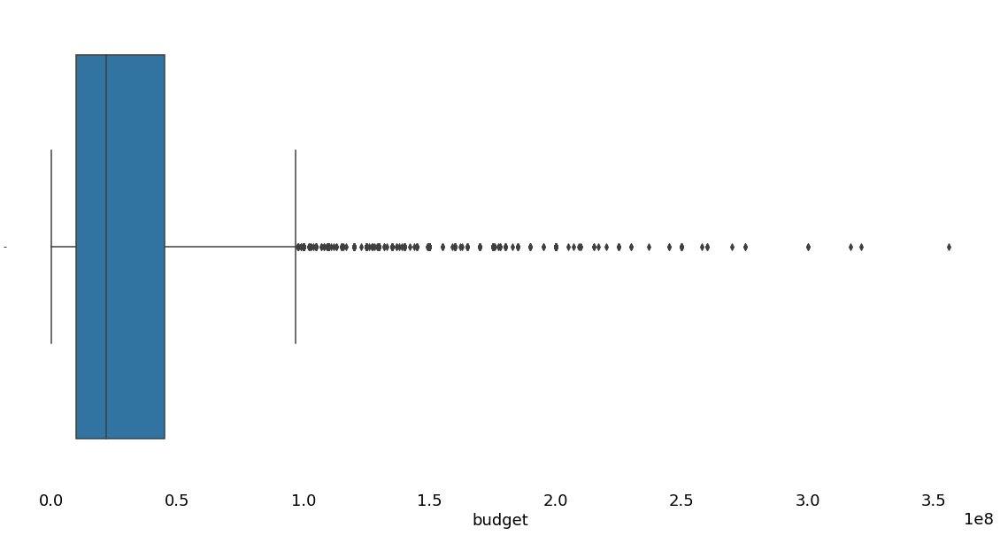

In [37]:

# To display box plot for specific column
sns.boxplot(x=df['budget'])


<AxesSubplot:xlabel='gross'>

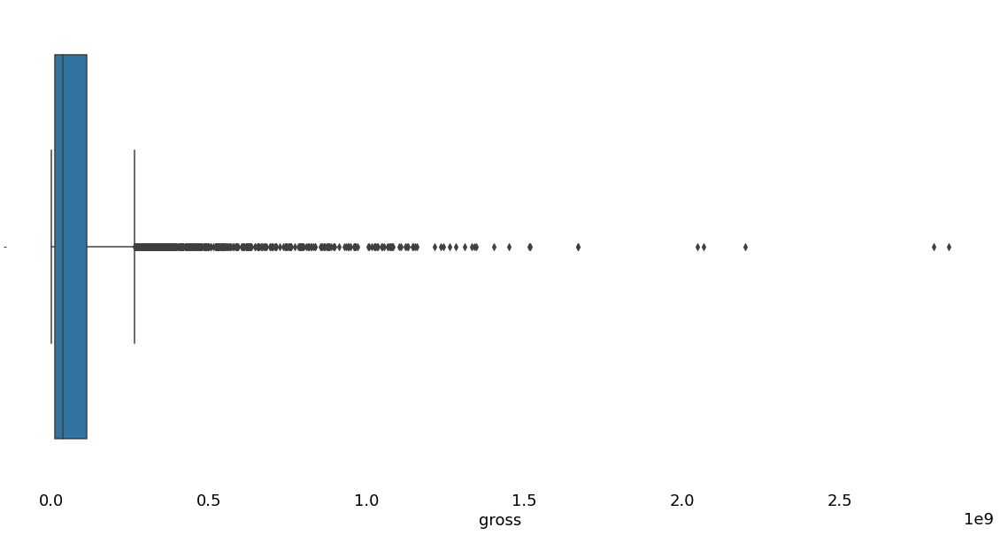

In [38]:
# To display box plot for specific column
sns.boxplot(x=df['gross'])

In [39]:
'''
# To display box plot for specific column
sns.boxplot(x=df['column_name'])
'''

"\n# To display box plot for specific column\nsns.boxplot(x=df['column_name'])\n"

Outliers are a point or set of points that are different from other points, sometimes they can *be* very high or very low.  Outliers are one of the primary reasons for resulting in a less accurate model we are going to remove them using the IQR score technique.  Outliers can be seen with visualizations using a Box Plot.   
IQR score technique from [Towards Data Science](https://towardsdatascience.com/ways-to-detect-and-remove-the-outliers-404d16608dba).

In [40]:
# To display Quantile for IQR score
q1 = df.quantile(0.25)
q3 = df.quantile(0.75)
iqr_score = q3 - q1
print(iqr_score)

year               18.00
score               1.30
votes         110,000.00
budget     35,000,000.00
gross     101,726,107.00
runtime            23.00
dtype: float64


In [41]:
df = df[~((df < (q1 - 1.5 * iqr_score)) |(df > (q3 + 1.5 * iqr_score))).any(axis=1)]
df.shape

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  """Entry point for launching an IPython kernel.


(4384, 15)



---



### 5.2. Histograms

Use histogram display the frequency of occurrence of variables in an interval.

In [42]:
'''
# To display histograms for all columns
df.columns.value_counts().nlargest(40).plot(kind='bar', figsize=(10,5))
'''

"\n# To display histograms for all columns\ndf.columns.value_counts().nlargest(40).plot(kind='bar', figsize=(10,5))\n"

In [43]:
'''
# To display histogram for specific column
df.Economy.value_counts().nlargest(40).plot(kind='bar', figsize=(10,5))
plt.title("Number of cars by make")
plt.ylabel('Number of cars')
plt.xlabel('Make');
'''

'\n# To display histogram for specific column\ndf.Economy.value_counts().nlargest(40).plot(kind=\'bar\', figsize=(10,5))\nplt.title("Number of cars by make")\nplt.ylabel(\'Number of cars\')\nplt.xlabel(\'Make\');\n'

### 5.3. Heat Maps

Use heat maps to find the dependent variables.

,year,score,votes,budget,gross,runtime
year,1.00,0.03,0.32,0.23,0.25,0.06
score,0.03,1.00,0.40,-0.11,0.06,0.37
votes,0.32,0.40,1.00,0.32,0.58,0.18
budget,0.23,-0.11,0.32,1.00,0.56,0.25
gross,0.25,0.06,0.58,0.56,1.00,0.13
runtime,0.06,0.37,0.18,0.25,0.13,1.00


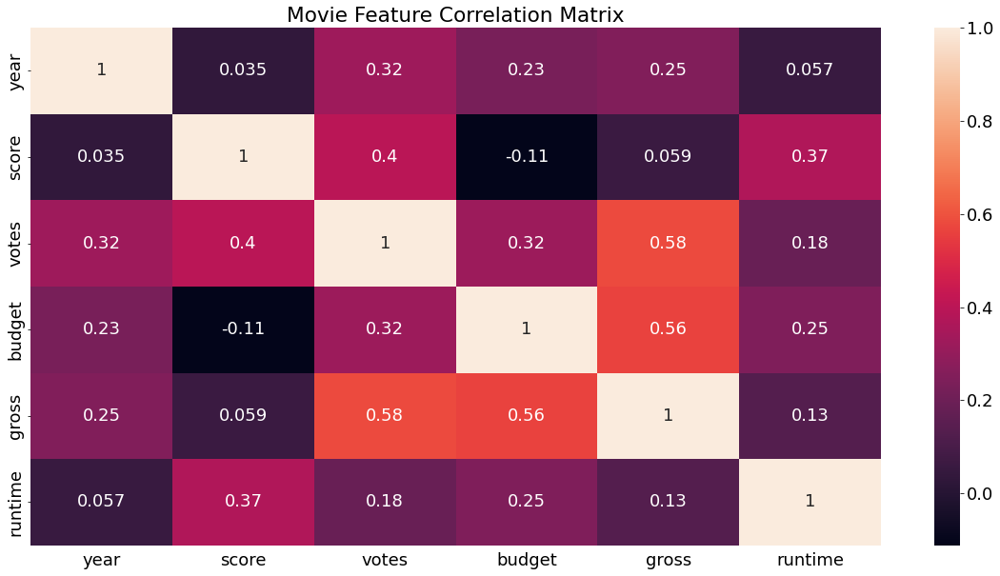

In [44]:
# To calculate the correlation coefficient matrix
df_corr = df.corr()
# To plot the Heat Map
sns.heatmap(df_corr, annot=True)
plt.title('Movie Feature Correlation Matrix')
plt.show
df_corr

### 5.4. Scatter plots

Use scatter plots to find the correlation between two variables.

In [45]:
'''
# To display scatter plot using matplotlib
plt.scatter(x=df['column_name_a'], y=df['column_name_b'])
plt.xlabel('column_name_a')
plt.ylabel('column_name_b')
plt.show()
'''

"\n# To display scatter plot using matplotlib\nplt.scatter(x=df['column_name_a'], y=df['column_name_b'])\nplt.xlabel('column_name_a')\nplt.ylabel('column_name_b')\nplt.show()\n"

<function matplotlib.pyplot.show(close=None, block=None)>

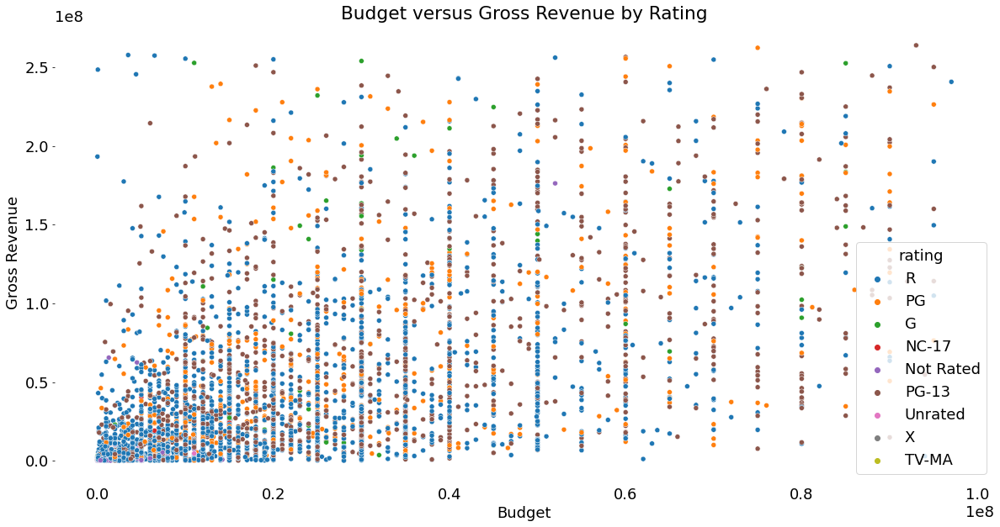

In [46]:
# To display scatter plot using sanborn
sns.scatterplot(data=df, x='budget', y='gross', hue='rating')
plt.xlabel('Budget')
plt.ylabel('Gross Revenue')
plt.title('Budget versus Gross Revenue by Rating')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

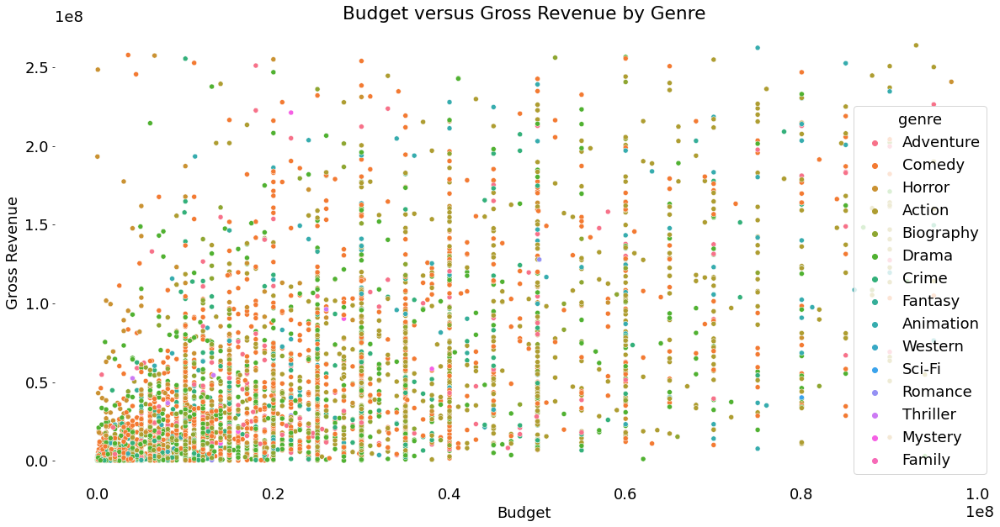

In [47]:
# To display scatter plot using sanborn
sns.scatterplot(data=df, x='budget', y='gross', hue='genre')
plt.xlabel('Budget')
plt.ylabel('Gross Revenue')
plt.title('Budget versus Gross Revenue by Genre')
plt.show

### 5.5. Regression plots


Use regression plots to analyze two variables.  
*regplot()* or *lmplot()*


In [48]:
'''
# To display regression plot
sns.lmplot(x='column_name_a', y='column_name_b', data=df)
'''

"\n# To display regression plot\nsns.lmplot(x='column_name_a', y='column_name_b', data=df)\n"

<function matplotlib.pyplot.show(close=None, block=None)>

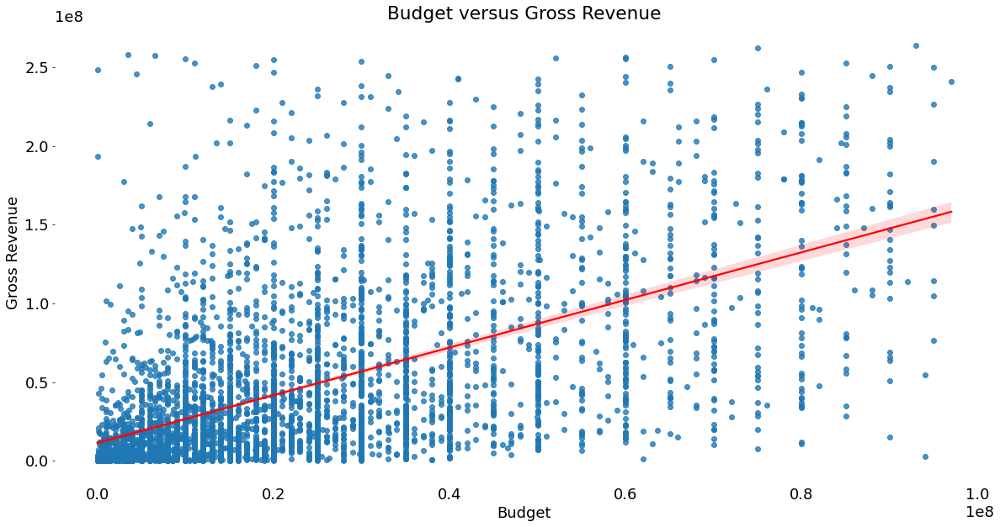

In [49]:
# To display regression plot using seaborn
sns.regplot(x='budget', y='gross', data=df, line_kws={'color':'red'})
plt.xlabel('Budget')
plt.ylabel('Gross Revenue')
plt.title('Budget versus Gross Revenue')
plt.show

In [50]:
'''
# To display regression plot with hue
sns.lmplot(x='column_name_a', y='column_name_b', cue='column_hue' data=df)
'''

"\n# To display regression plot with hue\nsns.lmplot(x='column_name_a', y='column_name_b', cue='column_hue' data=df)\n"

## 6. DataPrep Report

DataPrep lets you prepare your data using a single library with a few lines of code.  
https://docs.dataprep.ai/index.html#

DataPrep EDA  
Introduction to Exploratory Data Analysis and dataprep.eda

Exploratory Data Analysis (EDA) is the process of exploring a dataset and getting an understanding of its main characteristics. The dataprep.eda package simplifies this process by allowing the user to explore important characteristics with simple APIs. Each API allows the user to analyze the dataset from a high level to a low level, and from different perspectives. Specifically, dataprep.eda provides the following functionality:

https://docs.dataprep.ai/user_guide/eda/introduction.html

In [51]:
# To pip install dataprep and import create_report
!pip install dataprep
from dataprep.eda import create_report

     |████████████████████████████████| 1.8 MB 5.1 MB/s eta 0:00:01
     |████████████████████████████████| 125 kB 74.6 MB/s eta 0:00:01
     |████████████████████████████████| 1.5 MB 68.2 MB/s eta 0:00:01
     |████████████████████████████████| 848 kB 68.4 MB/s eta 0:00:01
     |████████████████████████████████| 63 kB 2.1 MB/s  eta 0:00:01
     |████████████████████████████████| 719 kB 66.8 MB/s eta 0:00:01
     |████████████████████████████████| 49 kB 4.4 MB/s  eta 0:00:01
     |████████████████████████████████| 743 kB 55.7 MB/s eta 0:00:01
  Created wheel for metaphone: filename=Metaphone-0.6-py3-none-any.whl size=13919 sha256=f486a5bdc75bf9c8006e66ce28a19cbc731cf3e7a21a42886756111b8318d306
  Stored in directory: /root/.cache/pip/wheels/1d/a8/cb/6f8902aa5457bd71344e00665c230e9c45255b3f57f2194a0f
Successfully built metaphone
  Attempting uninstall: jinja2
    Found existing installation: Jinja2 3.0.1
    Uninstalling Jinja2-3.0.1:
      Successfully uninstalled Jinja2-3.0.1
  Attempt

/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infav

  0%|          | 0/1903 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infav

DataPrep Report
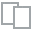
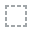
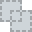
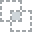
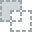
...
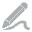
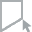
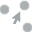
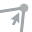
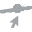

In [52]:
# To use DataPrep package to create interactive report on pandas dataframe
create_report(df)

## 7. Present Results

### 7.1. Data analysis observations

1.   Movies grossing higher correlates to more voting
2.   Movies grossing higher correlates to higher budget
3.   Movies scoring higher correlates to more voting
4.   Movies runtime correlates slightly to score
5.   Director, Star, Writer, Released, Year, Genre have minimal correlation



### 7.2. Data analysis conclusions




1.   What are the highest grossing movies?  **Charlie's Angels**
2.   Highest budget movies?  **Alien: Covenant**
3.   What movie(s) receive highest votes?  **From Dusk Till Dawn, The Wrestler, The Nice Guys**
4.   What movie(s) receives the highest score?  **Capharnaüm**
5.   What metrics make a successful movie?  **Higher budget, higher grossing films score higher**
6.   What studios/company has highest grossing movies?  **Universal Pictures, Columbia Pictures**
7.   What studios/company has the highest budget movies?  **Universal Pictures, Columbia Pictures**



In [53]:
df.nlargest(1, 'gross')

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
3659,Charlie's Angels,PG-13,Action,2000,"November 3, 2000 (United States)",5.60,"179,000.00",McG,Ryan Rowe,Cameron Diaz,United States,"93,000,000.00","264,105,545.00",Columbia Pictures,98.00


In [54]:
df.nlargest(1, 'budget')

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
7063,Alien: Covenant,R,Horror,2017,"May 19, 2017 (United States)",6.40,"261,000.00",Ridley Scott,Dan O'Bannon,Michael Fassbender,United States,"97,000,000.00","240,891,763.00",Twentieth Century Fox,122.00


In [55]:
df.nlargest(3, 'votes')

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
2848,From Dusk Till Dawn,R,Action,1996,"January 19, 1996 (United States)",7.20,"294,000.00",Robert Rodriguez,Robert Kurtzman,Harvey Keitel,United States,"19,000,000.00","25,837,111.00",Dimension Films,108.00
5276,The Wrestler,R,Drama,2008,"January 30, 2009 (United States)",7.90,"294,000.00",Darren Aronofsky,Robert Siegel,Mickey Rourke,United States,"6,000,000.00","44,734,660.00",Wild Bunch,109.00
6873,The Nice Guys,R,Action,2016,"May 20, 2016 (United States)",7.40,"294,000.00",Shane Black,Shane Black,Russell Crowe,United States,"50,000,000.00","62,788,218.00",Warner Bros.,116.00


In [56]:
df.nlargest(3, 'score')

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
7302,Capharnaüm,R,Drama,2018,"September 20, 2018 (Lebanon)",8.40,"71,000.00",Nadine Labaki,Nadine Labaki,Zain Al Rafeea,Lebanon,"4,000,000.00","64,417,003.00",Mooz Films,126.00
3129,Children of Heaven,PG,Drama,1997,"January 22, 1999 (United States)",8.30,"68,000.00",Majid Majidi,Majid Majidi,Mohammad Amir Naji,Iran,"180,000.00","933,933.00",Kanun parvaresh fekri,89.00
5664,Incendies,R,Drama,2010,"January 12, 2011 (France)",8.30,"158,000.00",Denis Villeneuve,Denis Villeneuve,Lubna Azabal,Canada,"6,800,000.00","7,099,598.00",micro_scope,131.00


In [61]:
df_pivot = pd.pivot_table(df, index=['company'],
                          values=['gross'],
                          aggfunc='sum')

df_pivot = df_pivot.reindex(df_pivot['gross'].sort_values( ascending=False).index)

print(df_pivot)

                                      gross
company                                    
Universal Pictures        17,738,338,809.00
Columbia Pictures         15,762,023,505.00
Paramount Pictures        13,776,781,933.00
Warner Bros.              12,716,551,152.00
Twentieth Century Fox     11,627,812,333.00
...                                     ...
.406 Production                   10,580.00
Enderby Entertainment              8,315.00
Two Prong Lesson                   5,073.00
Copperheart Entertainment          2,554.00
Daybreak                             309.00

[1358 rows x 1 columns]


In [62]:
df_pivot = pd.pivot_table(df, index=['company'],
                          values=['budget'],
                          aggfunc='sum')

df_pivot = df_pivot.reindex(df_pivot['budget'].sort_values( ascending=False).index)

print(df_pivot)

                                budget
company                               
Universal Pictures    7,920,730,000.00
Columbia Pictures     7,764,407,000.00
Warner Bros.          7,344,400,000.00
Paramount Pictures    6,488,450,000.00
Twentieth Century Fox 4,958,600,000.00
...                                ...
Bellanova Films              50,000.00
Desperate Pictures           22,769.00
Solana Films                 15,000.00
ERBP                          7,000.00
Next Wave Films               6,000.00

[1358 rows x 1 columns]
